### Predicting  Sweet's Selling Category

In [1]:
import pandas as pd
pd.options.display.max_rows = 4000
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
pio.templates.default = "plotly_white"

# PANDAS

In [2]:
import pandas as pd
df = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Sweet mart FY 2022 data.xlsx")
df.head()

,Shop Name,Bill Date,Bill Time,Bill No,Customer,Customer GSTN,Pincode,hsn,UOM,ItemCode,...,creditamt,roundamt,ItemSpotDiscountAmt,ItemPointsAmt,Dayofweek,Quarter,Month,Day,Fortnight,Fortnight-MM
0,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140,Nos,194,...,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
1,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140,Nos,193,...,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
2,﻿CX Talegaon,2021-01-01,NaN,11312200002,NaN,NaN,NaN,40140,Nos,194,...,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
3,﻿CX Talegaon,2021-01-01,NaN,11312200003,NaN,NaN,NaN,21069099,Nos,218,...,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
4,﻿CX Talegaon,2021-01-01,NaN,11312200003,NaN,NaN,NaN,21069099,Nos,115,...,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan


In [3]:
df.tail(5)

,Shop Name,Bill Date,Bill Time,Bill No,Customer,Customer GSTN,Pincode,hsn,UOM,ItemCode,...,creditamt,roundamt,ItemSpotDiscountAmt,ItemPointsAmt,Dayofweek,Quarter,Month,Day,Fortnight,Fortnight-MM
115080,﻿CX Talegaon,2021-12-31,21:12:44,227329229,NaN,NaN,NaN,21069099,Nos,110,...,0,0.0,0.0,0.0,Friday,4,Dec,31,2,2nd Fortnight - Dec
115081,﻿CX Talegaon,2021-12-31,21:13:51,227329230,Deelipe pathk,NaN,NaN,21069099,Nos,302,...,0,0.0,0.0,0.0,Friday,4,Dec,31,2,2nd Fortnight - Dec
115082,﻿CX Talegaon,2021-12-31,21:18:27,227329231,NaN,NaN,NaN,40140,Nos,193,...,0,0.0,0.0,0.0,Friday,4,Dec,31,2,2nd Fortnight - Dec
115083,﻿CX Talegaon,2021-12-31,21:18:27,227329231,NaN,NaN,NaN,21069099,Nos,218,...,0,0.0,0.0,0.0,Friday,4,Dec,31,2,2nd Fortnight - Dec
115084,﻿CX Talegaon,2021-12-31,21:38:19,227329232,NaN,NaN,NaN,21069099,Nos,142,...,0,0.0,0.0,0.0,Friday,4,Dec,31,2,2nd Fortnight - Dec


In [88]:
df.describe()

,Bill No,Pincode,hsn,ItemCode,SaleQty,MRP,CGSTRate,SGSTRate,GSTRate,CGSTAmount,SGSTAmount,GSTAmount,Discount,ItemAmount,BillAmount,BillDiscountAmt,BillSpotDiscountAmt,pointsamt,cashamt,walletamt,salereturnamt,creditamt,roundamt,ItemSpotDiscountAmt,ItemPointsAmt,Quarter,Day,Fortnight
count,1.150850e+05,34531.0,1.150850e+05,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,114604.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.0,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000
mean,2.195696e+10,0.0,1.473510e+07,139.822913,1.423261,100.089871,0.035619,0.035619,0.071237,4.702482,4.702482,9.404963,0.524919,135.581920,470.574045,0.243965,0.067162,1.408756,302.051023,88.370989,0.001564,0.0,0.000004,0.032498,0.416135,2.541513,15.196359,1.496077
std,4.108485e+10,0.0,8.679730e+06,92.844441,2.593886,79.618780,0.025199,0.025199,0.050397,16.393637,16.393637,32.787275,10.235080,522.423014,922.261812,3.375419,5.575550,16.511291,641.186662,328.836913,0.530595,0.0,0.000210,5.375295,8.536067,1.127175,8.804839,0.499987
min,2.200121e+07,0.0,4.014000e+04,1.000000,0.010000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-40.000000,0.000000,0.000000,0.000000,0.000000,-54.000000,-55.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
25%,2.273121e+08,0.0,4.039090e+06,72.000000,1.000000,47.620000,0.025000,0.025000,0.050000,1.190000,1.190000,2.380000,0.000000,60.000000,153.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.000000,8.000000,1.000000
50%,2.273253e+08,0.0,2.106910e+07,121.000000,1.000000,75.000000,0.025000,0.025000,0.050000,3.330000,3.330000,6.660000,0.000000,92.000000,320.000000,0.000000,0.000000,0.000000,170.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,3.000000,14.000000,1.000000
75%,1.131211e+10,0.0,2.106910e+07,200.000000,1.000000,130.000000,0.060000,0.060000,0.120000,5.000000,5.000000,10.000000,0.000000,159.170000,586.000000,0.000000,0.000000,0.000000,415.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,4.000000,23.000000,2.000000
max,1.131220e+11,0.0,4.202222e+07,414.000000,560.000000,840.000000,0.090000,0.090000,0.180000,3333.330000,3333.330000,6666.660000,1749.000000,140000.000000,140000.000000,282.400000,1300.000000,1749.000000,140000.000000,26735.000000,180.000000,0.0,0.010000,1300.000000,1749.000000,4.000000,31.000000,2.000000


In [90]:
print(df.isnull().sum())

Shop Name                   0
Bill Date                   0
Bill Time               49114
Bill No                     0
Customer                67089
Customer GSTN          114997
Pincode                 80554
hsn                         0
UOM                         0
ItemCode                    0
Item                        0
Category                    0
SubCategory                12
SaleQty                     0
MRP                         0
CGSTRate                    0
SGSTRate                    0
GSTRate                     0
CGSTAmount                  0
SGSTAmount                  0
GSTAmount                   0
Discount                    0
ItemAmount                  0
BillAmount                  0
BillDiscountAmt             0
BillSpotDiscountAmt       481
pointsamt                   0
cashamt                     0
cardamt                     0
walletamt                   0
salereturnamt               0
creditamt                   0
roundamt                    0
ItemSpotDi

### Explaratory Data Analysis (EDA)

<h4> Let’s have a look at data dimensionality, feature names, and feature types.

In [4]:
df.shape                                    

(115085, 41)

In [5]:
df.size

4718485

<h4> Checking all colomn names from data frame

In [6]:

df.columns                                 

Index(['Shop Name', 'Bill Date', 'Bill Time', 'Bill No', 'Customer',
       'Customer GSTN', 'Pincode', 'hsn', 'UOM', 'ItemCode', 'Item',
       'Category', 'SubCategory', 'SaleQty', 'MRP', 'CGSTRate', 'SGSTRate',
       'GSTRate', 'CGSTAmount', 'SGSTAmount', 'GSTAmount', 'Discount',
       'ItemAmount', 'BillAmount', 'BillDiscountAmt', 'BillSpotDiscountAmt',
       'pointsamt', 'cashamt', 'cardamt', 'walletamt', 'salereturnamt',
       'creditamt', 'roundamt', 'ItemSpotDiscountAmt', 'ItemPointsAmt',
       'Dayofweek', 'Quarter', 'Month', 'Day', 'Fortnight', 'Fortnight-MM'],
      dtype='object')

<h4> We can use the info() method to output some general information about the dataframe</h4>

In [7]:
df.info()                                

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115085 entries, 0 to 115084
Data columns (total 41 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   Shop Name            115085 non-null  object        
 1   Bill Date            115085 non-null  datetime64[ns]
 2   Bill Time            65971 non-null   object        
 3   Bill No              115085 non-null  int64         
 4   Customer             47996 non-null   object        
 5   Customer GSTN        88 non-null      object        
 6   Pincode              34531 non-null   float64       
 7   hsn                  115085 non-null  int64         
 8   UOM                  115085 non-null  object        
 9   ItemCode             115085 non-null  int64         
 10  Item                 115085 non-null  object        
 11  Category             115085 non-null  object        
 12  SubCategory          115073 non-null  object        
 13  SaleQty       

<h4> The describe method shows basic statistical characteristics of each numerical feature (int64 and float64 types): number of non-missing values, mean, standard deviation, range, median, 0.25 and 0.75 quartiles.

In [8]:
df.describe()

,Bill No,Pincode,hsn,ItemCode,SaleQty,MRP,CGSTRate,SGSTRate,GSTRate,CGSTAmount,...,cashamt,walletamt,salereturnamt,creditamt,roundamt,ItemSpotDiscountAmt,ItemPointsAmt,Quarter,Day,Fortnight
count,1.150850e+05,34531.0,1.150850e+05,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,...,115085.000000,115085.000000,115085.000000,115085.0,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000,115085.000000
mean,2.195696e+10,0.0,1.473510e+07,139.822913,1.423261,100.089871,0.035619,0.035619,0.071237,4.702482,...,302.051023,88.370989,0.001564,0.0,0.000004,0.032498,0.416135,2.541513,15.196359,1.496077
std,4.108485e+10,0.0,8.679730e+06,92.844441,2.593886,79.618780,0.025199,0.025199,0.050397,16.393637,...,641.186662,328.836913,0.530595,0.0,0.000210,5.375295,8.536067,1.127175,8.804839,0.499987
min,2.200121e+07,0.0,4.014000e+04,1.000000,0.010000,0.010000,0.000000,0.000000,0.000000,0.000000,...,-54.000000,-55.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
25%,2.273121e+08,0.0,4.039090e+06,72.000000,1.000000,47.620000,0.025000,0.025000,0.050000,1.190000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.000000,8.000000,1.000000
50%,2.273253e+08,0.0,2.106910e+07,121.000000,1.000000,75.000000,0.025000,0.025000,0.050000,3.330000,...,170.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,3.000000,14.000000,1.000000
75%,1.131211e+10,0.0,2.106910e+07,200.000000,1.000000,130.000000,0.060000,0.060000,0.120000,5.000000,...,415.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,4.000000,23.000000,2.000000
max,1.131220e+11,0.0,4.202222e+07,414.000000,560.000000,840.000000,0.090000,0.090000,0.180000,3333.330000,...,140000.000000,26735.000000,180.000000,0.0,0.010000,1300.000000,1749.000000,4.000000,31.000000,2.000000


In [9]:
df.describe(include=["object"])

,Shop Name,Bill Time,Customer,Customer GSTN,UOM,Item,Category,SubCategory,cardamt,Dayofweek,Month,Fortnight-MM
count,115085,65971,47996,88,115085,115085,115085,115073,115085,115085,115085,115085
unique,1,21588,6028,4,2,217,24,52,951,7,12,24
top,﻿CX Talegaon,22:34:01,Abcd,.,Nos,Bakarwadi 250 g,Packed Mithai,Packed Mithai -,0,Sunday,Aug,1st Fortnight - Sep
freq,115085,48,342,61,114179,7121,30455,16702,104866,18168,12355,7380


<h4> Sorting And Value Count

For categorical (type object) and boolean (type bool) features we can use the value_counts method. Let's have a look at the distribution of <b>Day of week </b>:

A DataFrame can be sorted by the value of one of the variables (i.e columns). For example, we can sort by <b>Day of week</b> (use ascending=False to sort in descending order)

In [10]:
df["Dayofweek"].value_counts().sort_values(ascending=False)

Sunday       18168
Saturday     17844
Thursday     17475
Friday       17070
Tuesday      15501
Monday       14960
Wednesday    14067
Name: Dayofweek, dtype: int64

By this we can see the <b>  Top 3 sale </b> is done on <b> Sunday , Saturday  </b>  and  <b> Thursday </b>

#### Grouping 


In [11]:
df.groupby(['Dayofweek'])['MRP'].sum().sort_values(ascending=False)

Dayofweek
Sunday       1881776.27
Saturday     1816487.91
Thursday     1760964.61
Friday       1707351.74
Tuesday      1535308.28
Monday       1424349.64
Wednesday    1392604.32
Name: MRP, dtype: float64

By This we can see total Sell done on each day <b> Top 3 </b> days are  <b>Sunday(18,81,776) , Saturday(18,16,487) </b> and <b> Thursday (17,60,964) </b>

####  Now we will try to elaborate Date feature.

In [12]:
df['year'] = pd.DatetimeIndex(df['Bill Date']).year

In [13]:
df['month'] = pd.DatetimeIndex(df['Bill Date']).month

In [14]:
df['day'] = pd.DatetimeIndex(df['Bill Date']).day

In [15]:
df['Total Sales'] = df['MRP'] * df['SaleQty']

In [16]:
df.head(2)

,Shop Name,Bill Date,Bill Time,Bill No,Customer,Customer GSTN,Pincode,hsn,UOM,ItemCode,...,Dayofweek,Quarter,Month,Day,Fortnight,Fortnight-MM,year,month,day,Total Sales
0,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140,Nos,194,...,Friday,1,Jan,1,1,1st Fortnight - Jan,2021,1,1,48.0
1,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140,Nos,193,...,Friday,1,Jan,1,1,1st Fortnight - Jan,2021,1,1,58.0


In [17]:
df.groupby(['year','month','Quarter'])['MRP'].sum().sort_values(ascending=False)   

year  month  Quarter
2021  8      3          1319798.00
      9      3          1315575.00
      10     4          1164477.00
      1      1          1135223.00
      11     4          1100679.00
      7      3          1036231.00
      12     4           845626.00
      3      1           844684.00
      6      2           839822.37
      2      1           798225.00
      4      2           666131.97
      5      2           452370.43
Name: MRP, dtype: float64

By This we can see total sales done on <b>Top 3 </b> months are <b>August(13,19,798) , September(13,15,575) and October (11,64,477)</b><br> i.e In <b> Q3 </b> and <b> Q4 </b>The sales have reach to higher point.

In [18]:
 df.groupby(['Category','Quarter'])['SubCategory'].value_counts()

Category         Quarter  SubCategory    
Bakarwadi        1        Bakarwadi          3433
                 2        Bakarwadi          2119
                 3        Bakarwadi          3388
                 4        Bakarwadi          2669
Binge Bar        3        Bhel Bar             10
                          Lite Bar              8
                          Lemon Bar             7
                 4        Bhel Bar            113
                          Lemon Bar            81
                          Lite Bar             71
ButterMilk       1        Butter Milk Pla     801
                          Butter Milk Spi     651
                 2        Butter Milk Pla     730
                          Butter Milk Spi     396
                 3        Butter Milk Pla     659
                          Butter Milk Spi     217
                 4        Butter Milk Pla     733
                          Butter Milk Spi     320
Cheese           1        Cheese              220
        

IN above table we can see that Number of product been sold as per the Quater and Category wise. <br> for Example 
Category
<b>Bakarwadi </b> is been sold <b>3433</b> times in <b> Q1</b>

#### Indexing and retrieving data

The <b> loc </b> method is used for <b>indexing by name</b>, while <b>iloc()</b> is used for <b>indexing by number.</b>

In [19]:
df.loc[0:5 , 'Shop Name':'hsn']

,Shop Name,Bill Date,Bill Time,Bill No,Customer,Customer GSTN,Pincode,hsn
0,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140
1,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140
2,﻿CX Talegaon,2021-01-01,NaN,11312200002,NaN,NaN,NaN,40140
3,﻿CX Talegaon,2021-01-01,NaN,11312200003,NaN,NaN,NaN,21069099
4,﻿CX Talegaon,2021-01-01,NaN,11312200003,NaN,NaN,NaN,21069099
5,﻿CX Talegaon,2021-01-01,NaN,11312200004,NaN,NaN,NaN,40140


In [20]:
df.iloc[0:5 , 0:8]

,Shop Name,Bill Date,Bill Time,Bill No,Customer,Customer GSTN,Pincode,hsn
0,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140
1,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140
2,﻿CX Talegaon,2021-01-01,NaN,11312200002,NaN,NaN,NaN,40140
3,﻿CX Talegaon,2021-01-01,NaN,11312200003,NaN,NaN,NaN,21069099
4,﻿CX Talegaon,2021-01-01,NaN,11312200003,NaN,NaN,NaN,21069099


In [21]:
df[:1]

,Shop Name,Bill Date,Bill Time,Bill No,Customer,Customer GSTN,Pincode,hsn,UOM,ItemCode,...,Dayofweek,Quarter,Month,Day,Fortnight,Fortnight-MM,year,month,day,Total Sales
0,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140,Nos,194,...,Friday,1,Jan,1,1,1st Fortnight - Jan,2021,1,1,48.0


In [22]:
df[-1:]

,Shop Name,Bill Date,Bill Time,Bill No,Customer,Customer GSTN,Pincode,hsn,UOM,ItemCode,...,Dayofweek,Quarter,Month,Day,Fortnight,Fortnight-MM,year,month,day,Total Sales
115084,﻿CX Talegaon,2021-12-31,21:38:19,227329232,NaN,NaN,NaN,21069099,Nos,142,...,Friday,4,Dec,31,2,2nd Fortnight - Dec,2021,12,31,140.0


#### Drop coloumns

In [23]:
new_df = df.drop(columns=['Bill Date'])

In [24]:
new_df.columns

Index(['Shop Name', 'Bill Time', 'Bill No', 'Customer', 'Customer GSTN',
       'Pincode', 'hsn', 'UOM', 'ItemCode', 'Item', 'Category', 'SubCategory',
       'SaleQty', 'MRP', 'CGSTRate', 'SGSTRate', 'GSTRate', 'CGSTAmount',
       'SGSTAmount', 'GSTAmount', 'Discount', 'ItemAmount', 'BillAmount',
       'BillDiscountAmt', 'BillSpotDiscountAmt', 'pointsamt', 'cashamt',
       'cardamt', 'walletamt', 'salereturnamt', 'creditamt', 'roundamt',
       'ItemSpotDiscountAmt', 'ItemPointsAmt', 'Dayofweek', 'Quarter', 'Month',
       'Day', 'Fortnight', 'Fortnight-MM', 'year', 'month', 'day',
       'Total Sales'],
      dtype='object')

#### Summary tables

#### Lets calculate now total sales Quarter wise.

In [25]:
pd.crosstab([df.Category],df.Quarter)

Quarter,1,2,3,4
Category,,,,
Bakarwadi,3433,2119,3388,2669
Binge Bar,0,0,25,265
ButterMilk,1452,1126,876,1053
Cheese,220,259,214,152
Chutney,0,0,0,64
Dahi,1359,1184,2020,1790
Festival Gift P,0,0,145,390
Flavoured Milk,734,420,669,719
Ghee,569,508,730,679


In [26]:
pd.crosstab([df.Category],df.ItemAmount.sum(),colnames=['Total Sales']).sort_values(by=df.ItemAmount.sum(),ascending=False)

Total Sales,15603445.28
Category,
Packed Mithai,30455
Namkeen,22945
Bakarwadi,11609
Shrikhand,9318
Milk,9157
Dahi,6353
ButterMilk,4507
Lassi,2947
Instant Mix,2702


The Total sales is <b>15603445.28</b> (One Crore Fifty Six Lakhs Three Thousand Four Hundred Forty Five and Twenty Eight paise)

In [27]:
pd.crosstab([df.Category,df.Month],df.SaleQty.sum(),rownames=['Category', "Month"],colnames=['SaleQty'])

SaleQty                163796.02
Category        Month           
Bakarwadi       Apr          647
                Aug         1225
                Dec          807
                Feb         1032
                Jan         1540
                Jul         1065
                Jun          909
                Mar          861
                May          563
                Nov          931
                Oct          931
                Sep         1098
Binge Bar       Dec           22
                Nov           58
                Oct          185
                Sep           25
ButterMilk      Apr          588
                Aug          271
                Dec          243
                Feb          384
                Jan          259
                Jul          334
                Jun          310
                Mar          809
                May          228
                Nov          330
                Oct          480
                Sep          271
Cheese          Apr           89
                Aug           88
                Dec           41
                Feb           70
                Jan           85
                Jul           82
                Jun           76
                Mar           65
                May           94
                Nov           46
                Oct           65
                Sep           44
Chutney         Dec           40
                Nov           19
                Oct            5
Dahi            Apr          372
                Aug          737
                Dec          499
                Feb          379
                Jan          364
                Jul          587
                Jun          481
                Mar          616
                May          331
                Nov          558
                Oct          733
                Sep          696
Festival Gift P Aug          145
                Nov          220
                Oct          170
Flavoured Milk  Apr          174
                Aug          251
                Dec          154
                Feb          177
                Jan          298
                Jul          217
                Jun          159
                Mar          259
                May           87
                Nov          267
                Oct          298
                Sep          201
Ghee            Apr          164
                Aug          278
                Dec          209
                Feb          173
                Jan          222
                Jul          196
                Jun          204
                Mar          174
                May          140
                Nov          188
                Oct          282
                Sep          256
ICECream        Apr          124
                Aug          269
                Dec          161
                Feb           20
                Jan          154
                Jul          158
                Jun           75
                Mar          206
                May           25
                Nov          193
                Oct          258
                Sep          141
Instant Mix     Apr          230
                Aug          278
                Dec          150
                Feb          201
                Jan          312
                Jul          303
                Jun          271
                Mar          182
                May          200
                Nov          175
                Oct          230
                Sep          170
Jam             Apr           57
                Aug           51
                Dec           46
                Feb           85
                Jan          106
                Jul           52
                Jun           54
                Mar           69
                May           31
                Nov           31
                Oct           43
                Sep           54
Ketchup         Apr           57
       

In [28]:
df.isna().sum().sort_values(ascending=False)[:7]          #Checking null values from data frame()

Customer GSTN          114997
Pincode                 80554
Customer                67089
Bill Time               49114
BillSpotDiscountAmt       481
SubCategory                12
Dayofweek                   0
dtype: int64

# Vizualization using Matplotlib

In [29]:
dic = dict(df.groupby(['Quarter'])['MRP'].sum())
print(dic.keys())
print(dic.values())

dict_keys([1, 2, 3, 4])
dict_values([2778132.0, 1958324.77, 3671604.0, 3110782.0])


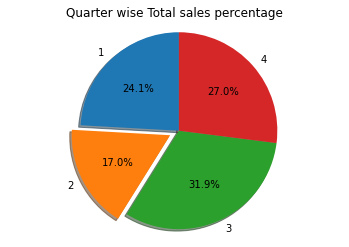

In [30]:
import matplotlib.pyplot as plt

# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = list(dic.keys())
sizes = list(dic.values())
explode = (0, 0.1, 0, 0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title('Quarter wise Total sales percentage')
plt.show()

In [31]:
dic = dict(df.groupby(['Category'])['MRP'].sum())
print(dic.keys())
print(dic.values())

dict_keys(['Bakarwadi', 'Binge Bar', 'ButterMilk', 'Cheese', 'Chutney', 'Dahi', 'Festival Gift P', 'Flavoured Milk', 'Ghee', 'ICECream', 'Instant Mix', 'Jam', 'Ketchup', 'Lassi', 'Loni', 'MS Square NAS', 'Mango Pulp', 'Merchandizing', 'Milk', 'Milk Powder', 'Namkeen', 'Packed Mithai', 'Paneer', 'Shrikhand'])
dict_values([1399505.54, 2900.0, 59679.37, 122782.62, 2880.0, 269770.0, 153275.0, 66294.54, 811722.64, 216129.35, 230028.28, 22654.22, 41704.73, 58939.32, 308769.75, 46730.0, 87905.22, 620.0, 248463.56, 12899.13, 1744438.31, 4547817.66, 176274.16, 886659.37])


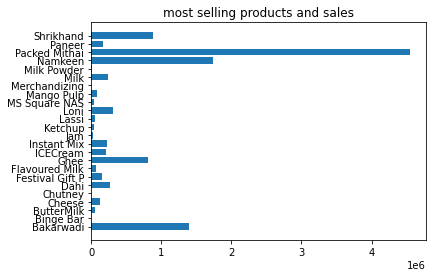

In [32]:
# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = list(dic.keys())
sizes = list(dic.values())

fig1, ax1 = plt.subplots()
ax1.barh(labels,sizes)
plt.title('most selling products and sales')
plt.show()

In [33]:
dic = dict(df.groupby(['Dayofweek'])['MRP'].sum())
print(dic.keys())
print(dic.values())

dict_keys(['Friday', 'Monday', 'Saturday', 'Sunday', 'Thursday', 'Tuesday', 'Wednesday'])
dict_values([1707351.74, 1424349.64, 1816487.91, 1881776.27, 1760964.61, 1535308.28, 1392604.32])


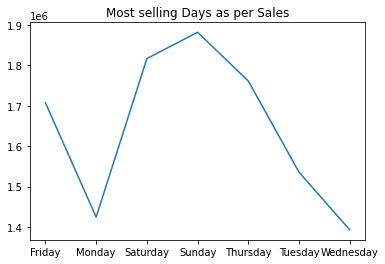

In [34]:
# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = list(dic.keys())
sizes = list(dic.values())

fig1, ax1 = plt.subplots()
ax1.plot(labels,sizes)
plt.title('Most selling Days as per Sales')
plt.show()

In [35]:
dic = dict(df.groupby(['Month'])['MRP'].sum())
print(dic.keys())
print(dic.values())

dict_keys(['Apr', 'Aug', 'Dec', 'Feb', 'Jan', 'Jul', 'Jun', 'Mar', 'May', 'Nov', 'Oct', 'Sep'])
dict_values([666131.97, 1319798.0, 845626.0, 798225.0, 1135223.0, 1036231.0, 839822.37, 844684.0, 452370.43, 1100679.0, 1164477.0, 1315575.0])


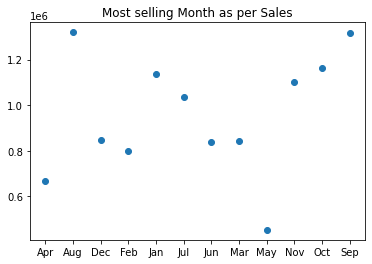

In [36]:
# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = list(dic.keys())
sizes = list(dic.values())

fig1, ax1 = plt.subplots()
ax1.scatter(labels,sizes)
plt.title('Most selling Month as per Sales')
plt.show()

In [37]:
dic = dict(df.groupby(['SubCategory'])['MRP'].sum())
print(dic.keys())
print(dic.values())

dict_keys(['Bakarwadi ', 'Bhel Bar', 'Burfi - Badam', 'Burfi - Mango', 'Burfi - Pista', 'Butter Milk Pla', 'Butter Milk Spi', 'Chakka', 'Cheese ', 'Dahi Bowl', 'Dahi Pouch', 'Festival Gift P', 'Flavoured Milk', 'Flavoured Milk ', 'Fresh Milk', 'Ghee', 'Ghee Cow', 'Ice Cream', 'Instant Mix - G', 'Instant Mix - I', 'Instant Mix - K', 'Instant Mix - M', 'Jam - Mango', 'Jam - Mix Fruit', 'Katali & Roll', 'Ketchup ', 'Lassi - Mango', 'Lassi - Rose', 'Lassi - Sweeten', 'Lemon Bar', 'Lite Bar', 'Loni', 'Mango Pulp ', 'Merchandising', 'NAS Gulabjam', 'NAS Kaju Katli', 'NAS Soanpapdi', 'Namkeen', 'Namkeen - Chaka', 'Namkeen - Chiva', 'Namkeen - Dal', 'Namkeen - Shev', 'Packed Mithai -', 'Paneer', 'SMP', 'Shrikhand - Amb', 'Shrikhand - Bad', 'Shrikhand - Ela', 'Shrikhand - Kes', 'Soan Papdi', 'Tamrind Chutney', 'Til'])
dict_values([1399505.54, 1230.0, 85142.95, 562285.29, 172028.72, 43839.37, 15840.0, 12180.0, 122782.62, 38541.0, 219049.0, 153990.0, 925.0, 65369.54, 248463.56, 384472.68, 427249.

<Figure size 576x576 with 0 Axes>

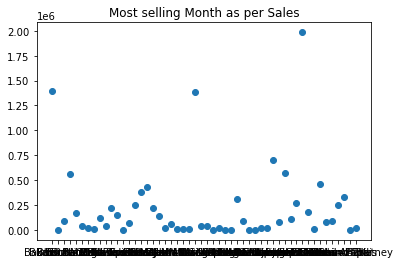

In [38]:
# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = list(dic.keys())
sizes = list(dic.values())

# changing the size of figure to 2X2
plt.figure(figsize=(8,8))

fig1, ax1 = plt.subplots()
ax1.scatter(labels,sizes)
plt.title('Most selling Month as per Sales')
plt.show()

In [39]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


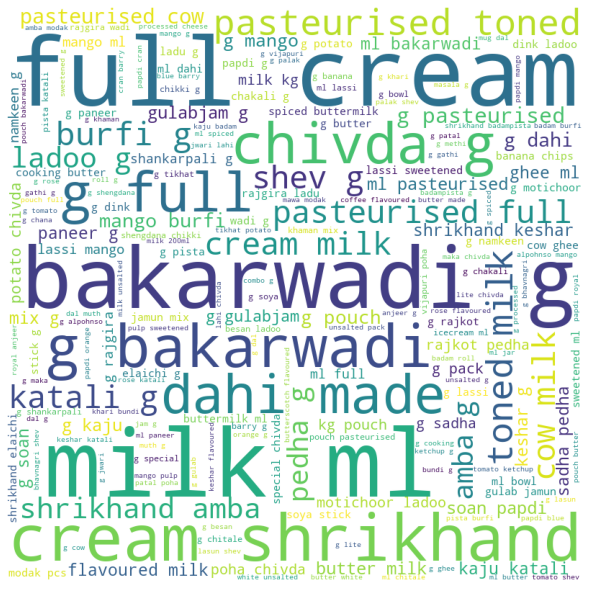

In [40]:
# importing all necessary modules
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import pandas as pd
 
# Reads 'Youtube04-Eminem.csv' file
df = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Sweet mart FY 2022 data.xlsx")
 
comment_words = ''
stopwords = set(STOPWORDS)
 
# iterate through the csv file
for val in df.Item:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
 
plt.show()

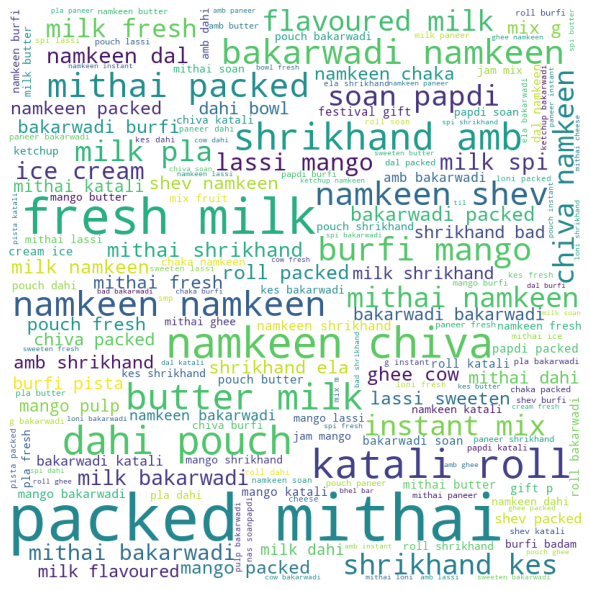

In [41]:
# importing all necessary modules
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
import pandas as pd
 
# Reads 'Youtube04-Eminem.csv' file
df = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Sweet mart FY 2022 data.xlsx")
 
comment_words = ''
stopwords = set(STOPWORDS)
 
# iterate through the csv file
for val in df.SubCategory:
     
    # typecaste each val to string
    val = str(val)
 
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
     
    comment_words += " ".join(tokens)+" "
 
wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
 
plt.show()

# Pandas Sql 

In [42]:
!pip install -U pandasql

In [43]:
from pandasql import sqldf

In [44]:
import numpy as np

In [45]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

In [46]:
import plotly.express as px

In [47]:
q = "SELECT * FROM df LIMIT 3"
sqldf(q, globals())

,Shop Name,Bill Date,Bill Time,Bill No,Customer,Customer GSTN,Pincode,hsn,UOM,ItemCode,...,creditamt,roundamt,ItemSpotDiscountAmt,ItemPointsAmt,Dayofweek,Quarter,Month,Day,Fortnight,Fortnight-MM
0,﻿CX Talegaon,2021-01-01 00:00:00.000000,None,11312200001,None,None,None,40140,Nos,194,...,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
1,﻿CX Talegaon,2021-01-01 00:00:00.000000,None,11312200001,None,None,None,40140,Nos,193,...,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
2,﻿CX Talegaon,2021-01-01 00:00:00.000000,None,11312200002,None,None,None,40140,Nos,194,...,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan


<b>Overall Day wise Sales Figures  

In [48]:
q = "SELECT Dayofweek as [Day of week]  , sum(SaleQty) as [SaleQty]  , sum(ItemAmount) as [TotalSale] FROM df GROUP BY Dayofweek" 
sqldf(q, globals())

,Day of week,SaleQty,TotalSale
0,Friday,24262.00,2290411.18
1,Monday,21437.01,1876849.09
2,Saturday,25435.00,2486369.41
3,Sunday,25124.00,2441158.65
4,Thursday,24355.00,2321295.09
5,Tuesday,22166.01,2120838.50
6,Wednesday,21017.00,2066523.36


In [49]:
df[['Dayofweek','ItemAmount']]

,Dayofweek,ItemAmount
0,Friday,48.0
1,Friday,58.0
2,Friday,48.0
3,Friday,136.0
4,Friday,89.0
...,...,...
115080,Friday,70.0
115081,Friday,170.0
115082,Friday,60.0
115083,Friday,150.0


In [50]:
dic = dict(df.groupby(['Dayofweek'])['ItemAmount'].sum())
print(dic.keys())
print(dic.values())

dict_keys(['Friday', 'Monday', 'Saturday', 'Sunday', 'Thursday', 'Tuesday', 'Wednesday'])
dict_values([2290411.18, 1876849.09, 2486369.41, 2441158.65, 2321295.09, 2120838.5, 2066523.36])


In [51]:
fig = px.bar(df, x=dic.keys(), y=dic.values(), title="Day Wise Total Sale for period JAN- of 21 to DEC-21")
fig.show()

<b> Average Sale on a Day of a week    


In [52]:
q = "SELECT Dayofweek as [Day of week]  , sum(SaleQty) as [SaleQty]  , sum(ItemAmount) as [TotalSale] , sum(ItemAmount)/52 as [Average Sale on a day of week] FROM df GROUP BY Dayofweek" 
sqldf(q, globals())

,Day of week,SaleQty,TotalSale,Average Sale on a day of week
0,Friday,24262.00,2290411.18,44046.368846
1,Monday,21437.01,1876849.09,36093.251731
2,Saturday,25435.00,2486369.41,47814.796346
3,Sunday,25124.00,2441158.65,46945.358654
4,Thursday,24355.00,2321295.09,44640.290192
5,Tuesday,22166.01,2120838.50,40785.355769
6,Wednesday,21017.00,2066523.36,39740.833846


In [53]:
dic = dict(df.groupby(['Dayofweek'])['ItemAmount'].sum()/52)
print(dic.keys())
print(dic.values())

dict_keys(['Friday', 'Monday', 'Saturday', 'Sunday', 'Thursday', 'Tuesday', 'Wednesday'])
dict_values([44046.36884615385, 36093.25173076923, 47814.796346153846, 46945.35865384615, 44640.290192307686, 40785.355769230766, 39740.83384615385])


In [54]:
fig = px.bar(df, x=dic.keys(), y=dic.values(), title="Average Sale on day of week")
fig.show()

<b>Overall Monthly Sales Figures    


In [55]:
q = "SELECT Month as [Month]  , sum(SaleQty) as [SaleQty]  , sum(ItemAmount) as [TotalSale]  FROM df GROUP BY Month" 
sqldf(q, globals())

,Month,SaleQty,TotalSale
0,Apr,11374.00,900673.11
1,Aug,16695.00,1676199.01
2,Dec,11196.00,1063677.16
3,Feb,12089.00,1075849.18
4,Jan,15422.00,1473083.53
5,Jul,13846.00,1270221.04
6,Jun,11975.00,1060215.48
7,Mar,14411.00,1120426.78
8,May,7465.02,600064.92
9,Nov,17176.00,2068392.03


In [56]:
dic = dict(df.groupby(['Month'])['ItemAmount'].sum())
print(dic.keys())
print(dic.values())

dict_keys(['Apr', 'Aug', 'Dec', 'Feb', 'Jan', 'Jul', 'Jun', 'Mar', 'May', 'Nov', 'Oct', 'Sep'])
dict_values([900673.11, 1676199.01, 1063677.16, 1075849.18, 1473083.53, 1270221.04, 1060215.48, 1120426.78, 600064.92, 2068392.03, 1669549.05, 1625093.99])


In [57]:
fig = px.bar(df, x=dic.keys(), y=dic.values(), title="Monthly Total Sale for the period Jan-21 to Dec-21")
fig.show()

<b> Overall Fortnightly Sales Figures    


In [58]:
q = "SELECT [Fortnight-MM] as [Fortnight-Month]  , sum(SaleQty) as [SaleQty]  , sum(ItemAmount) as [TotalSale]  FROM df GROUP BY [Fortnight-MM] ORDER BY  [Fortnight-MM]" 
sqldf(q, globals())

,Fortnight-Month,SaleQty,TotalSale
0,1st Fortnight - Apr,7211.00,585933.00
1,1st Fortnight - Aug,7074.00,673834.01
2,1st Fortnight - Dec,4970.00,472148.01
3,1st Fortnight - Feb,6036.00,538114.18
4,1st Fortnight - Jan,7875.00,771425.53
5,1st Fortnight - Jul,6481.00,572896.98
6,1st Fortnight - Jun,5501.00,463442.22
7,1st Fortnight - Mar,6827.00,542104.30
8,1st Fortnight - May,3070.00,251122.34
9,1st Fortnight - Nov,11528.00,1537167.02


In [59]:
dic = dict(df.groupby(['Fortnight-MM'])['ItemAmount'].sum())
print(dic.keys())
print(dic.values())

dict_keys(['1st Fortnight - Apr', '1st Fortnight - Aug', '1st Fortnight - Dec', '1st Fortnight - Feb', '1st Fortnight - Jan', '1st Fortnight - Jul', '1st Fortnight - Jun', '1st Fortnight - Mar', '1st Fortnight - May', '1st Fortnight - Nov', '1st Fortnight - Oct', '1st Fortnight - Sep', '2nd Fortnight - Apr', '2nd Fortnight - Aug', '2nd Fortnight - Dec', '2nd Fortnight - Feb', '2nd Fortnight - Jan', '2nd Fortnight - Jul', '2nd Fortnight - Jun', '2nd Fortnight - Mar', '2nd Fortnight - May', '2nd Fortnight - Nov', '2nd Fortnight - Oct', '2nd Fortnight - Sep'])
dict_values([585933.0, 673834.01, 472148.01, 538114.18, 771425.53, 572896.98, 463442.22, 542104.3, 251122.34, 1537167.02, 644769.01, 1073003.0, 314740.11, 1002365.0, 591529.15, 537735.0, 701658.0, 697324.06, 596773.26, 578322.48, 348942.58, 531225.01, 1024780.04, 552090.99])


In [60]:
fig = px.line(df, x=dic.keys(), y=dic.values(), title="Fortnightly Total Sale")
fig.show()

In [61]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [62]:
df.groupby(['Item'])['ItemAmount'].sum().sort_values(ascending=False).head(6)

Item
Bakarwadi 500 g       958654.02
Bakarwadi 250 g       933544.94
Mango Burfi 250 g     756224.36
Kaju Katali 250 g     660667.08
Sadha Pedha 200 g     505266.89
Rajkot Pedha 250 g    491761.04
Name: ItemAmount, dtype: float64

In [63]:
Month = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Monthly sales of top 5 Items sale.xlsx")
Day = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Day.xlsx")
Bakarwadi_500g = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Bakarwadi 500 g.xlsx")
Bakarwadi_250g = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Bakarwadi 250 g.xlsx")
MangoBurfi_250g_month = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\MangoBurfi_250g_month.xlsx")
MangoBurfi_250g_day = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\MangoBurfi_250g_day.xlsx")
KajuKatali_250g = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Kaju Katali 250 g.xlsx")
RajkotPedha_250g = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Rajkot Pedha 250 g.xlsx")
SadhaPedha_250g = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Sadha Pedha 200 g.xlsx")

In [64]:
fig = px.line(df, x=Month['Month'], y=Month['ItemAmount'], color=Month['Item'],title="Monthly sale of Top 5 Items - Jan-21 to Dec-21")
fig.show()

In [65]:
Day = pd.read_excel(r"C:\Users\Chandan\OneDrive\Desktop\UnRar\Bhola Project\Bhola Project\Data\Day.xlsx")

In [66]:
fig = px.line(df, x=Day['Day'], y=Day['ItemAmount'], color=Day['Item'],title="Day wise sale for top 5 Items based on the total sale during the period  Jan-21 to Dec-21")
fig.show()

In [67]:
fig = px.line(df, x=Bakarwadi_500g['Month'], y=Bakarwadi_500g['ItemAmount'], color=Bakarwadi_500g['Day'],title="Daywise monthly trend for Bakarwadi 500 g for the period Jan-21 to Dec-21")
fig.show()

In [68]:
fig = px.line(df, x=Bakarwadi_250g['Month'], y=Bakarwadi_250g['ItemAmount'], color=Bakarwadi_250g['Day'],title="Daywise monthly trend for Bakarwadi 250 g for the period Jan-21 to Dec-21")
fig.show()

In [69]:
fig = px.line(df, x=MangoBurfi_250g_month['Month'], y=MangoBurfi_250g_month['ItemAmount'], color=MangoBurfi_250g_month['Day'],title="Daywise monthly trend for Mango Barfi - 250 g")
fig.show()

In [70]:
fig = px.line(df, x=MangoBurfi_250g_day['Day'], y=MangoBurfi_250g_day['ItemAmount'], title="Daywise total Sale Amount for the month of May-21 for Mango Barfi 250 g")
fig.show()



In [71]:
fig = px.line(df, x=KajuKatali_250g['Month'], y=KajuKatali_250g['ItemAmount'],color=KajuKatali_250g['Day'] ,title="Daywise monthly trend for Kaju Katli 205 g for the period Jan-21 to Dec-21 ")
fig.show()

In [72]:
fig = px.line(df, x=RajkotPedha_250g['Month'], y=RajkotPedha_250g['ItemAmount'], color=RajkotPedha_250g['Day'] ,title="Daywise monthly sale of Rajkot Pedha 250 g for the period Jan-21 to Dec-21")
fig.show()

In [73]:
fig = px.line(df, x=SadhaPedha_250g['Month'], y=SadhaPedha_250g['ItemAmount'],color=SadhaPedha_250g['Day'] ,title="Daywise monthly trend for Sadha Pedha 200 g for the period Jan-21 to Dec-21  ")
fig.show()

In [74]:
q = '''SELECT  Distinct(SaleQty) as [Sale Qty] , count([Bill No]) FROM df Group by SaleQty '''   
print(sqldf(q,globals()))

    Sale Qty  count([Bill No])
0       0.01                 2
1       1.00             89424
2       2.00             17719
3       3.00              3217
4       4.00              2597
5       5.00               698
6       6.00               633
7       7.00               141
8       8.00               210
9       9.00                34
10     10.00               167
11     11.00                18
12     12.00                65
13     13.00                10
14     14.00                10
15     15.00                12
16     16.00                15
17     17.00                 2
18     18.00                 5
19     20.00                21
20     21.00                 1
21     22.00                 1
22     23.00                 3
23     24.00                 3
24     25.00                 7
25     26.00                 1
26     27.00                 2
27     28.00                 2
28     29.00                 1
29     30.00                13
30     31.00                 1
31     3

# Market Basket Analysis 
### Market Basket Analysis is a data-driven technique used to uncover patterns and relationships within large transactional datasets, particularly in retail and e-commerce. It helps businesses understand which products or items are often purchased together, providing insights for optimizing product placement, marketing strategies, and promotions. 

In [75]:
df.columns  

Index(['Shop Name', 'Bill Date', 'Bill Time', 'Bill No', 'Customer',
       'Customer GSTN', 'Pincode', 'hsn', 'UOM', 'ItemCode', 'Item',
       'Category', 'SubCategory', 'SaleQty', 'MRP', 'CGSTRate', 'SGSTRate',
       'GSTRate', 'CGSTAmount', 'SGSTAmount', 'GSTAmount', 'Discount',
       'ItemAmount', 'BillAmount', 'BillDiscountAmt', 'BillSpotDiscountAmt',
       'pointsamt', 'cashamt', 'cardamt', 'walletamt', 'salereturnamt',
       'creditamt', 'roundamt', 'ItemSpotDiscountAmt', 'ItemPointsAmt',
       'Dayofweek', 'Quarter', 'Month', 'Day', 'Fortnight', 'Fortnight-MM'],
      dtype='object')

In [76]:
pd.set_option('display.max_columns', None) 
df.head() 

,Shop Name,Bill Date,Bill Time,Bill No,Customer,Customer GSTN,Pincode,hsn,UOM,ItemCode,Item,Category,SubCategory,SaleQty,MRP,CGSTRate,SGSTRate,GSTRate,CGSTAmount,SGSTAmount,GSTAmount,Discount,ItemAmount,BillAmount,BillDiscountAmt,BillSpotDiscountAmt,pointsamt,cashamt,cardamt,walletamt,salereturnamt,creditamt,roundamt,ItemSpotDiscountAmt,ItemPointsAmt,Dayofweek,Quarter,Month,Day,Fortnight,Fortnight-MM
0,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140,Nos,194,Pasteurised Cow Milk 500 ml,Milk,Fresh Milk,2.0,24.0,0.000,0.000,0.00,0.0,0.0,0.0,0.0,48.0,106.0,0.0,0.0,0.0,106.0,0,0.0,0,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
1,﻿CX Talegaon,2021-01-01,NaN,11312200001,NaN,NaN,NaN,40140,Nos,193,Pasteurised Full Cream Milk 500 ml,Milk,Fresh Milk,2.0,29.0,0.000,0.000,0.00,0.0,0.0,0.0,0.0,58.0,106.0,0.0,0.0,0.0,106.0,0,0.0,0,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
2,﻿CX Talegaon,2021-01-01,NaN,11312200002,NaN,NaN,NaN,40140,Nos,194,Pasteurised Cow Milk 500 ml,Milk,Fresh Milk,2.0,24.0,0.000,0.000,0.00,0.0,0.0,0.0,0.0,48.0,48.0,0.0,0.0,0.0,48.0,0,0.0,0,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
3,﻿CX Talegaon,2021-01-01,NaN,11312200003,NaN,NaN,NaN,21069099,Nos,218,Sadha Pedha 200 g,Packed Mithai,Packed Mithai -,1.0,130.0,0.025,0.025,0.05,3.0,3.0,6.0,0.0,136.0,215.0,0.0,0.0,0.0,215.0,0,0.0,0,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan
4,﻿CX Talegaon,2021-01-01,NaN,11312200003,NaN,NaN,NaN,21069099,Nos,115,Til Ladu 250 g,Packed Mithai,Til,1.0,85.0,0.025,0.025,0.05,2.0,2.0,4.0,0.0,89.0,215.0,0.0,0.0,0.0,215.0,0,0.0,0,0,0.0,0.0,0.0,Friday,1,Jan,1,1,1st Fortnight - Jan


### Now let’s have a look at the distribution of the prices of the products:


In [77]:
fig = px.histogram(df, x='Item', 
                   title='Item Distribution')
fig.show()


In [78]:
item_popularity = df.groupby('Item')['SaleQty'].sum().sort_values(ascending=False)

top_n = 10
fig = go.Figure()
fig.add_trace(go.Bar(x=item_popularity.index[:top_n], y=item_popularity.values[:top_n],
                     text=item_popularity.values[:top_n], textposition='auto',
                     marker=dict(color='skyblue')))
fig.update_layout(title=f'Top {top_n} Most Popular Items',
                  xaxis_title='Item Name', yaxis_title='Total Quantity Sold')
fig.show()

In [79]:
import pandas as pd
import plotly.graph_objects as go

# Assuming your dataset is named 'df'
customer_behavior = df.groupby('Bill No').agg({'SaleQty': 'mean', 'MRP': 'sum'}).reset_index()

# Sort the DataFrame by 'Total Bill Amount' in descending order
customer_behavior_sorted = customer_behavior.sort_values(by='MRP', ascending=True)

table_data = pd.DataFrame({
    'Bill No': customer_behavior_sorted['Bill No'],
    'Average Sale Quantity': customer_behavior_sorted['SaleQty'],
    'Total Bill Amount': customer_behavior_sorted['MRP']
})

fig = go.Figure()

fig.add_trace(go.Scatter(x=customer_behavior_sorted['SaleQty'], y=customer_behavior_sorted['MRP'],
                         mode='markers', text=customer_behavior_sorted['Bill No'],
                         marker=dict(size=10, color='coral')))

fig.add_trace(go.Table(
    header=dict(values=['Bill No', 'Average Sale Quantity', 'Total Bill Amount']),
    cells=dict(values=[table_data['Bill No'], table_data['Average Sale Quantity'], table_data['Total Bill Amount']]),
))

fig.update_layout(title='Customer Behavior',
                  xaxis_title='Average Sale Quantity', yaxis_title='Total Bill Amount')

fig.show()


In [80]:
!pip install mlxtend


In [81]:
pd.set_option('display.max_rows', None)

In [82]:
from mlxtend.frequent_patterns import apriori, association_rules

# Group items by BillNo and create a list of items for each bill
basket = df.groupby('Bill No')['Item'].apply(list).reset_index()

# Encode items as boolean variables using one-hot encoding
basket_encoded = basket['Item'].str.join('|').str.get_dummies('|').astype(bool)

# Find frequent itemsets using Apriori algorithm with lower support
frequent_itemsets = apriori(basket_encoded, min_support=0.01, use_colnames=True)

# Generate association rules with lower lift threshold
rules = association_rules(frequent_itemsets, metric='lift', min_threshold=0.5)

# Display association rules in tabular form
association_table = rules[['antecedents', 'consequents', 'support', 'confidence', 'lift']].head(20)

association_table

,antecedents,consequents,support,confidence,lift
0,(Mango Burfi 250 g),(Bakarwadi 250 g),0.016284,0.250147,1.837970
1,(Bakarwadi 250 g),(Mango Burfi 250 g),0.016284,0.119646,1.837970
2,(Mango Burfi 250 g),(Bakarwadi 500 g),0.010627,0.163241,2.062075
3,(Bakarwadi 500 g),(Mango Burfi 250 g),0.010627,0.134235,2.062075
4,(Pasteurised Full Cream Milk 500 ml),(Pasteurised Cow Milk 500 ml),0.012595,0.136807,1.655034
5,(Pasteurised Cow Milk 500 ml),(Pasteurised Full Cream Milk 500 ml),0.012595,0.152370,1.655034


In [92]:
from mlxtend.frequent_patterns import apriori, association_rules

# Group items by BillNo and create a list of items for each bill
basket = df.groupby('Bill No')['SubCategory'].apply(list).reset_index()

# Encode items as boolean variables using one-hot encoding
basket_encoded = basket['SubCategory'].str.join('|').str.get_dummies('|').astype(bool)

# Find frequent itemsets using Apriori algorithm with lower support
frequent_itemsets = apriori(basket_encoded, min_support=0.01, use_colnames=True)

# Generate association rules with lower lift threshold
rules = association_rules(frequent_itemsets, metric='lift', min_threshold=0.5)

# Display association rules in tabular form
association_table = rules[['antecedents', 'consequents', 'support', 'confidence', 'lift']].head(20)

association_table

,antecedents,consequents,support,confidence,lift
0,(Bakarwadi ),(Burfi - Mango),0.027617,0.130098,1.856284
1,(Burfi - Mango),(Bakarwadi ),0.027617,0.394055,1.856284
2,(Bakarwadi ),(Katali & Roll),0.030026,0.141442,1.447115
3,(Katali & Roll),(Bakarwadi ),0.030026,0.307196,1.447115
4,(Bakarwadi ),(Namkeen),0.051145,0.240929,1.651932
5,(Namkeen),(Bakarwadi ),0.051145,0.350675,1.651932
6,(Bakarwadi ),(Namkeen - Chaka),0.010454,0.049248,2.152686
7,(Namkeen - Chaka),(Bakarwadi ),0.010454,0.456976,2.152686
8,(Bakarwadi ),(Namkeen - Chiva),0.035931,0.169263,1.707047
9,(Namkeen - Chiva),(Bakarwadi ),0.035931,0.362375,1.707047


In [84]:
from mlxtend.frequent_patterns import apriori, association_rules

# Group items by BillNo and create a list of items for each bill
basket = df.groupby('Bill No')['Category'].apply(list).reset_index()

# Encode items as boolean variables using one-hot encoding
basket_encoded = basket['Category'].str.join('|').str.get_dummies('|').astype(bool)

# Find frequent itemsets using Apriori algorithm with lower support
frequent_itemsets = apriori(basket_encoded, min_support=0.01, use_colnames=True)

# Generate association rules with lower lift threshold
rules = association_rules(frequent_itemsets, metric='lift', min_threshold=0.5)

# Display association rules in tabular form
association_table = rules[['antecedents', 'consequents', 'support', 'confidence', 'lift']].head(20)

association_table

,antecedents,consequents,support,confidence,lift
0,(Instant Mix),(Bakarwadi),0.011964,0.276380,1.301714
1,(Bakarwadi),(Instant Mix),0.011964,0.056351,1.301714
2,(Namkeen),(Bakarwadi),0.084840,0.340388,1.603185
3,(Bakarwadi),(Namkeen),0.084840,0.399586,1.603185
4,(Packed Mithai),(Bakarwadi),0.105157,0.260795,1.228314
5,(Bakarwadi),(Packed Mithai),0.105157,0.495274,1.228314
6,(Shrikhand),(Bakarwadi),0.028688,0.183205,0.862873
7,(Bakarwadi),(Shrikhand),0.028688,0.135116,0.862873
8,(ButterMilk),(Dahi),0.016800,0.202488,1.717667
9,(Dahi),(ButterMilk),0.016800,0.142510,1.717667


In [85]:
import os
os.chdir(r"C:\Users\Chandan\OneDrive\Desktop\CHANDAN LOHAR")

In [94]:
from mlxtend.frequent_patterns import apriori, association_rules

# Assuming 'df' is your DataFrame with columns 'Bill No' and 'SubCategory'

# Filter transactions containing 'mango barfi'
df_mango_barfi = df[df['SubCategory'] == 'Burfi - Mango']

# Group items by BillNo and create a list of items for each bill
basket = df_mango_barfi.groupby('Bill No')['SubCategory'].apply(list).reset_index()

# Encode items as boolean variables using one-hot encoding
basket_encoded = basket['SubCategory'].str.join('|').str.get_dummies('|').astype(bool)

# Find frequent itemsets using Apriori algorithm with lower support
frequent_itemsets = apriori(basket_encoded, min_support=0.01, use_colnames=True)

# Generate association rules with lower lift threshold
rules = association_rules(frequent_itemsets, metric='lift', min_threshold=0.5)

# Display association rules in tabular form
association_table = rules[['antecedents', 'consequents', 'support', 'confidence', 'lift']].head(20)

# Print or display the association table
print(association_table)

Empty DataFrame
Columns: [antecedents, consequents, support, confidence, lift]
Index: []
